In [1]:
import os
from IPython.display import Image  # for displaying images
import random
import shutil
from sklearn.model_selection import train_test_split
import xml.etree.ElementTree as ET
from xml.dom import minidom
from tqdm import tqdm
from PIL import Image, ImageDraw
import numpy as np
import matplotlib.pyplot as plt

# 1. Introduction

Our project aims to compare two different frameworks on a object detection task. Object detection is one of the most important areas in computer vision. It involves identifying the presence, location and type (class) of one or more instance on a given image and plays a key role in various practical applications.  
To compare different object detection algorithms we are going to use object sign dataset from <a href="https://makeml.app/datasets/road-signs">MakeML</a>. It includes 877 images of the following classes: Trafic Light, Stop, Speedlimit, Crosswalk. Annotations files of the dataset in Pascal Voc format. 

In [ ]:
# 2. Download Data

In [20]:
# Create an empty folder into the current working directory 
print("current working directory: ", os.getcwd())
print("\n documents before creating the dataset folder, ", os.listdir()) 
# Create Road_Sign_Dataset folder
!mkdir Road_Sign_Dataset
print("\n after mkdir command: ", os.listdir())


current working directory:  C:\Users\gokce\Documents\MSc_DataScience\Computer Vision\project2022

 documents before creating the dataset folder,  ['.ipynb_checkpoints', 'cmd_result.JPG', 'CV_Project', 'DataPreparation.ipynb', 'ExDark.zip', 'README.txt', 'RoadSignsPascalVOC.zip', 'yolov5']

 after mkdir command:  ['.ipynb_checkpoints', 'cmd_result.JPG', 'CV_Project', 'DataPreparation.ipynb', 'ExDark.zip', 'README.txt', 'RoadSignsPascalVOC.zip', 'Road_Sign_Dataset', 'yolov5']


In [2]:
# Change current directory into newly created dataset folder
!cd Road_Sign_Dataset
# Download the dataset

#!curl https://arcraftimages.s3-accelerate.amazonaws.com/Datasets/RoadSigns/RoadSignsPascalVOC.zip?region=us-east-2

The system cannot find the path specified.


In [25]:
os.listdir()


  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
  0     0    0     0    0     0      0      0 --:--:-- --:--:-- --:--:--     0
  0     0    0     0    0     0      0      0 --:--:--  0:00:01 --:--:--     0
  0  218M    0  390k    0     0   195k      0  0:19:07  0:00:02  0:19:05  172k
  1  218M    1 2850k    0     0   950k      0  0:03:55  0:00:03  0:03:52  881k
  2  218M    2 6194k    0     0  1548k      0  0:02:24  0:00:04  0:02:20 1462k
  4  218M    4 10.0M    0     0  2051k      0  0:01:49  0:00:05  0:01:44 2395k
  5  218M    5 13.0M    0     0  2219k      0  0:01:40  0:00:06  0:01:34 3043k
  7  218M    7 16.9M    0     0  2480k      0  0:01:30  0:00:07  0:01:23 3415k
  9  218M    9 20.6M    0     0  2640k      0  0:01:24  0:00:08  0:01:16 3654k
 11  218M   11 24.4M    0     0  2784k      0  0:01:20  0:00:09  0:01:11 3772k
 12  218M   12 27.7M    0     0  2841k      0  0:01:18  0:00:10  0:01:08 3632k
 14  218M   14 31.0M    0     0  2886k      0  0:01


AÔKœ×(¢úM¾ PKùù=”ð   4  PK ¯‹�P        °   "   __MACOSX/annotations/._road448.xmlUT
 Jw”^™w”^h¡”^ux õ     c`cg`b`ðMLVðVˆP€�'qƒøˆŽ!!AP&HÇ –@SÂˆMÎÏÕK,(ÈIÕ+,M,JÌ+ÉÌKe(Ô70°0²6Mµ4177I´öMÌNõõ±f  PK/ÄÊ½c   °   PK ¯‹�P        5     annotations/road474.xmlUT
 Jw”^™w”^Jw”^ux õ     e’Qr„ †ß÷=AY[[û�á{ „¨8‚SÝÓ¯mlëÓŸÿûã”s>ªHÞÉËÓþAçGƒ³$«z JY�è”E9{eê¦~ž\¿G¾Ý
t/2•_dâ _¯WY2�ú!Êú`E348} ²È³‡€½EÑÈ½�‹}û‰ú<.-&D3’‚7N|òåÍí	M¡‘ÄyqZ•ã¸à€×z\Læ?útê:ÒËÎZgZ¿²‘ÌÕ’“Uý"©ßpK°y±ý‡«U«¬>š£Sý»ÖK•:ÏÄy‹ýåAœþ“PKÒRyñ   5  PK ¯‹�P        °   "   __MACOSX/annotations/._road474.xmlUT
 Jw”^™w”^h¡”^ux õ     c`cg`b`ðMLVðVˆP€�'qƒøˆŽ!!AP&HÇ –@SÂˆMÎÏÕK,(ÈIÕ+,M,JÌ+ÉÌKe(Ô70°0²6Mµ4177I´öMÌNõõ±f  PK/ÄÊ½c   °   PK ®‹�P        2     annotations/road312.xmlUT
 Iw”^™w”^Iw”^ux õ     e’Mrƒ0…÷9EOP'!“n4¾E`lê`›3�ž¾þKEZ6è½ïI–N œóAòNžÞâ�
Î’¬êqQee4¢Såì•i.×÷Éõ1òtKh¡ïZfù ÙœÏ JÉh@ê‡ o‰Õš¡Á)õ�(E™-x8,Ø[t�Œí,
ôíêã¸¼à2!š‘,¼qæ“_P~

['.ipynb_checkpoints',
 'cmd_result.JPG',
 'CV_Project',
 'DataPreparation.ipynb',
 'ExDark.zip',
 'README.txt',
 'RoadSignsPascalVOC.zip',
 'Road_Sign_Dataset',
 'yolov5']


 Jw”^™w”^h¡”^ux õ     c`cg`b`ðMLVðVˆP€�'qƒøˆŽ!!AP&HÇ –@SÂˆMÎÏÕK,(ÈIÕ+,M,JÌ+ÉÌKe(Ô70°0²6Mµ4177I´öMÌNõõ±f  PK/ÄÊ½c   °   PK ®‹�P        ‰     annotations/road228.xmlUT
 Iw”^™w”^Iw”^ux õ     Ý“QNÄ †ß÷ž@v«»k“	·ØP˜¶c
4…ÆÖÓK¡
jbŒ�òôÏ|ÿÃ$@c½ðd
?Ü…­Nœ´èÐÛÃ�Ñ€Fhä“ªªžîGÓË{6™½î2†/¤|ÏŽG`IfÔ#u½ç�Ûu†
Ç­X©7ËÍÁa§ÑxT<”ç AÛ<£,ÛÅÝˆ¨Òä�å‰#­C~3Á!©%TÀb&ü4)öër�
VÊaV‰èâ=Ô¶$çÁo<ÙÐÕØ%'brÑdøé|Õg¸Fx­�­ßá¢Å`µUŠ¯mëËVYB`åáÅÿÙN¯Þi}úi§çßîXñ÷Þ PKÒìˆR  ‰  PK ®‹�P        °   "   __MACOSX/annotations/._road228.xmlUT
 Iw”^™w”^h¡”^ux õ     c`cg`b`ðMLVðVˆP€�'qƒøˆŽ!!AP&HÇ –@SÂˆMÎÏÕK,(ÈIÕ+,M,JÌ+ÉÌKe(Ô70°0²6Mµ4177±´öMÌNõõ±f  PK“	c   °   PK ¯‹�P        3     annotations/road599.xmlUT
 Jw”^™w”^Jw”^ux õ     e’]n„0„ß÷=AÃ¶‹T$+·èBbÀI-ôôK~¶¦-OãùÆŽqåœ*�wòòr|ÐùÑà,Éª¥,ŒFtÊ¢œ½2uÓ¼N®?"O7‡ú.2•w2a�ïU"KFR?y‹¬h†§Ø"‹<[ðpX°·èy´s‘¡o¿PŸÇ¥—	ÑŒd)€à�Ÿü‚òÓ	M¡‘„yuZ•ã¸à€×z\Mæ?útê:Òë"ç‚­3­ßØHæfÉÉæD¿Ù­ú
bÿÏ6«6ùVÝ

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)




˜N–8;ÿfÄÛršÉ¨Ëk³A¯:Çú}�þbPÿ‹�:|t‰7g‰)ª5¯ã
>zss¶s©þÎ�É1§1ªŒùs¯þe�ëÝžÝÓÃÀMÇLa–’ƒ_¶ÆE¸Þ$õÛ-†yé^?£’È¡{¿ÀË	w8È7pün6'¡ä‡°löæTf2 Ü§Â@§ ŠkSèáõýTû×={'
ñ+‘:}÷Ò|�'ÃÀs¸’!Zêì-�ê·u„`è£Ã§ ýiZ®ÒMp¡§�ŸGû±·³¾‹Í~Q¸¿Ê9ÞN«~?ÞFŸqév0‡ž'üñïÿ1þßdŒ�É7�­C mû£;³NK ®¼MîßÈx°û»Ó�y½à}rÆ‹YÅu­¯žâ±£�MgvÏ	/‰³¯²°Èÿ¡çðÄ[o÷ü±‡¤8˜^ÐùôUŸÏ¿)Ù	Þ,³7&ð‹üC×‡lk÷î}ú¯í·ß<îuïó¬áN‹ƒÝ't{ER4éz‰ˆ½;Ø˜üÆz/]š-ÒÇWÝx}ºùò³þã?÷œÚú¼‰`ú	}Ù·CÚ7Ä7Ý˜®e8îÏ@ªní§êl@w–2‹†ë?TÉK’ÝNQÑ‡'ºô´Òñè…÷õ±?Æôé?&xr/ñrÂð³6˜žŸ˜Â´‹3lŠC¯ŸBã÷è<:–yÜ»åšpŸ¾ÎgÙé‹ÍtdJ´#¦¯}ë6~	Ñ;/F]`1 †B7ÍfT‚!ð(Ÿð·&à{xÆÄgö½¶£xÌ}œr†ÇñðúW¹ÑÑU™K”õ>>Ð~4üºŽç%ðZËuJn}¢M©’cã•\ ³ 9ÿÆ¼æ�æ�_]ÕÇ×ñ„Þf}ÝDy”ª˜Ur¤Í Âw¼:UðµòðHw»ý `s:Nløá‹¢äšºÉßiõ~]& -d‚ýOç|‰½%E2(¬p¥ééaW9k‚›>vŠ?à¿6ÿ`ý4?æÀømBö�ï-H]�ÓŒåÁ£ý•ƒìo²BGá‰«´?Ã›MíÊå/n‰éÇt+�pëDíû}Iw¯ÿÖ­2KÐÑ%ßf>ÕŸ=ø¢W@_pîô^‚íøNí-‡\’´uƒ³«ßKt_âk;:Ü=sñHR¸X‰Ÿ%ÔLüE3Åo\)ÿ¯Û’ŒÓûÂNwÌ7W?¡éÊ g�«%–Tj£C°UwÀu}Â£òðˆ�Ž|ÃÃSŽ¿&ÅÛ!²Ç'É¢Ox ëüpPÇ#Ý÷âú•«¾£›<|o9ÝàŽs{Â`%Aƒ¾ú›>µÃ±I@½Îy_ÄC

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)




å=í¹_QÕóè9�&Û ÄÑësÊ×„å�ÞôM`š¼£||ÓV9ØX"ã³èv™ëwú5v†#v6š:S¨Óñ(°ÙJ›(1&l@u-u{LX>£Ã£…œ	`B¡Û¨Á›ÁOË»áûhe×ýÎ Žž´^S+ë·²†u9±1'ŠÃ&Ø¢å#áF-SŠ•R,rÉ �Ü�îçË°Ö[Tîô:kXãÁ=°mL
ÂÙm£�/ïRâÑÏ(åz“êà§z]õÑóÁ(Xµ	¨:ðaÄBòá\Þœnùî_˜�Ç§Mù‡÷îR"7	<²£"Bg£Ÿ­øiçÉ¢â3$¿�r,j«"7¬×V³6ÕE»–K•S’Bb²|r_¯-œÑê>š�·[†¿¢åEŒÛÃ÷†²çiÃ÷ƒÃ~ðô´g8eÎo<¦ðz˜B/Ò‚T
è¬
coš ýf¢·»ÿky·DUx!¡iFë�ÀLç9oÃ—C¦Kñ”±úuë&Zgù]~/�¶ÍÀ\±ÍÕ¶è(³‘>ú§Ýhð=Ð]sˆÚ“Ð©ó]$ë^ÿŽÎŸûþª®9_|¤×e.ÿM�—ò+yõ–W[,‡ràL§áuá²ÚœUiÙ�øç%#{Þ6§7ø]E6ÏÉUÏ»
-¼ŠÛâ´ÂxÖ¶�ö!z¶ô„à	ÕXû0è¬kŸyâzìo-w•náûf\&rÜ.ëç¤-÷
�ù`:….ã	Á3ñLÐ¯3»IàÊ"ó;C¯üþœ§žƒ
Ä¦;”ú eUY7
¤ÝÑîu-ë±�zïž#˜§—ádÀ‡YÇñj[=þpöDAàài¨ƒËÓÍée�3,-W™XmåØOÏÛ�àS@ÀÁÏ‚phâ”õÐ8´ l+¶²9ƒ÷ónÅiè¹Þ*jT×ÇÐÉƒÁ‡ÆB~
ô!/NAšñ•w¢æcÈ»qý‡,–ð™á_Í�¾ëîö¶eÔæ D=Œ‡gÛ¤9z¿P÷¾m„ÁKsNÝwïæ‡l¾pRË_]
.]2�‡g·÷¡wú
·>ÒÍCCœG-�qd{Ã¹ÊTöè�‹`öãèóÁéð€“tï´§§ø¨/–ˆÑÜû‰pú=]	çE°Éo[
È”ÎÝHV¾}¢éúË&çlÝZîqpÔ6ýmÀ¨“Ý0á>­®ê·ü”ôóâpÒ5Çó©Õ÷x¼…õðÃô®�Õ:Vwm›¨ÙÚ=�)çz�*”öÛ}ÁÒ"ûš·µilû+u\¢<öaõØ
'::õÆûè

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



/s+wbøóé±´W�n�®7wêÏéu¢�ú*ü&VNÄ·Äô—}Wþ¾?ÿü¼1;óõ_Éä;„ìŠ„A¦�ö[ó”£žV›GåG†néËËk`‘t/2Ae€³UÏ^fáwêOÉ¯f¾Ý²¬²r–™…çˆí„ê�:ôQöI)€ô»
;ÇÄ÷ÙðåÚ|×ZÊºY—ÀºÖ%ðK� íP‰åÌ¬ÞÅÄÚ½˜@ÿ$Â05ô¤Ô¢Z`Ÿ-W²§ª_„6ßÌË¿žkòJ¢£žï–=¿öWßv¥C±ÉSFF74q™A³(Ì=Çò5F £‹¯æ“V¿ù=øì·gpOÃ}Ã
TêCÕA:.f
åb·VèxŽ•ãvå8¯~à3�c« êx	_ÅÖ‘8¥”¸Õ�WË4w0Û´A¼ÒUÊ©¬qhë|Ñ¶Ç_Þ‰—îsA|Ô�C�ŸÃ«ôñéÀBíA)È£}îCºÞîSRH¦÷lB`—Ûë>¼ÄÇ®á·îr7KAÜê69m�©#qí´fèfT¬Pè›ØñØ-öDÇÅwí:üXó$¾ÈÌy’‚�ÊZ\Æi!Eê 5QÚPã¼B°lc¥àiÎß*Ð¶l;®¤ÏJq`£ð±–ƒèþÌþÌ¾‚ÿ“ÏþÉåú¤1ßÉßþÂw~lÌ‘g�,Až¯=}röµ[Èï‡¦¶OíƒÎ^T>›Á¾á#ÃÄ££îÎ!åYüw6ÇµU¤ží<]Ÿ$Â½æAýqºyº¹©9„œv|ì·?�¹=Ü¾÷·Ç€†ýÇ
P^±+¾ðI^”ô�&ì¤Or¬C�•‘,wPé°k·¡ÙpÊ{ð~¤Ÿ’œ˜‰ûÄnâdà€jêq�Ð™ X\,t ¦|ƒ‹b—÷Z…èÝ*Â	ùÝ®Øðí…£¬†_Éƒ°b5 {ÕŸtôÂóþyüÿîË‡î=t/+…¿wøÓ‡÷?zäî| ¹ßôÚ­¯-1ÀX>uÙÒeÈÛfWöBo…þåg×Nâ»Ÿ«gŒù+®ïà~ˆ+�Ç§Öpå®ÿž_½d~�ª±{z÷Æ¯°2òÀÆ;7vÑ÷ôžÞºÀÊÈö+¾|9t®ýìµ³×c>þå�úã_f ø°
ºh¯3×9cø+P*ùâ)wQriœò‡zœ‹¼kr¸S�r+†��òc€à±B+ÐkîÃHÎÉ$`TþVVÍ$|òÆ;Ê¢G(ù!W®¬¼ ä;ÜŠ�ð¶[è/G¨�
†aˆþé¼Ñlˆ´GaG¼÷�†ao
ôlÿHÿêÃõ/˜ �©dvV

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



4´'ÿ
þÛ^ŸjßŸ‡˜®§œa]ð?�þ{|°'jS3Ò„äxsS€þiÿYÿ9Ê‰.Èqþþ~{¿=åÿ„-ƒ_ï¯õ|ËÂ¦®éiÚô³ùüÉ·7Õ¼?éßößõ¿ÿ‰»ÅÝÏÈ•‚Ÿ3Øø	o×:<úhò:&çkD´†Dÿ¤¾ÕÇ­Àž”Ì6ƒ²5}ý®HZ÷%dÊ×³“sÈìL¤
çË–×°E‰ÿ·[oÊ²tüØûž|{BÊ@ÂžýH¾KÿBÙyzü×z<Ão¸–Â³Œë°Kœ¼SËG+?×ò‘'¹þq¼8ùIÄ^é^Áý	¼�LÏ\ÒìÍÿG»×ú#Ñé Þ¡¦g4«þt3�4ƒÌæxwÔ¥u
ˆ¾'¾íxÖÖà;ð¾„’¿­¹Ø}Õ3a¡½˜¿ÑÍìõú
È
õ
C&�ä·5ú`kH l¢ü(�–az§P[²;Ó-zÓZ–MXbkc~Žþ�Ç{<ójòò\)²{+µ¤%hö{ê%£›j-¸	¸u]ò5;u+{®œ‰ñSö¥ØÈ…z‘^é®ò”êÖÅñ¡æ·hûYÂ&Æì˜Ï¦Ÿ3ýêZ…–�çeïÇ•’ÞïÉê§ÇRwKk@|¨œ±Ú§V’+­Ë¸è•V»_}—¥¬‘Ø«<Ã®;É/á´[â«?-•…ÔM†¶¦Åß›5.z¦¿Éû:ÓfM|ŸLØ�<ˆ°ÏB;œÙ—á8Þ¿s|&ü7ò*�[¨ŸêŸ&ßdhWÞ.–ê[°zÞ®õdÉ?�•ÅN}¡8.ÛC¿Rú½ªß$oc‘%~>Šu‘ì¢Ü}ÌY‘JMpú;ÔDÛ¯Øù�WR¬õü½¢7í¡¬‰X*Ï¤çbVZ¾¯U¿?±ø¥1²Æ¤¬
Pôß‰w¶àç&Ÿþƒ“PýË4ó£H²2×øjÁ†Òà÷;ù[xÓ^š²–·~Å	ßX$W†j§Îz:nrá°AÎ<só×<Mñ�ÙÙø[þ38~…övŽ¿Åí;ë×¨çAý²
K{Ë´ºÿ¶ÁÏ»Ñî·å=™ß¥_¸ÚÍÖP´²VÒ¼?+oÁº–K~}Ëâ«ž6q'j}.Ÿïh
±®I¤ëmiØcíc—¹ú
¤­å‘«ÈhbŽ‰ÞeÚœüÍ?	‰óÓããÐëšÎ–�]¤x!‹yOVÌYw €ù5$*¯ÊQmû,BÉ‘~‡»ÝGôål{¯dMî¸ñîXêãp÷L^·ªµ!¡¥'ÎŽ½Ž=;Oï‡Œ¦×xßÒ>`u‚<�ÇÏä5;’ó‚ñEãA¤¶MíÃÒ:Ò?oNHãŸŒ

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



e?6¬À¢©É¶dÓÚ[¥Å¼J‡�H#¨;Ž¨�,4µg¹°0=¥Ñv•ëKÕõ·Ï  @ IDATté¼�ôv£±õ€É*wûæ0ó™¸ÆŠcûíÌ��Á7¶ºÐ¢ÍwídãV°`´€jš0›b7ÃÖÑÔˆ¿ÐX1ºmëÖg;ˆ÷é7wËÄ®Ó„›ú“÷?²×)ðèY89Æf˜ˆÌT;õ²UË=£§BVDxÐ–¦ÐE€O4+÷Ñ-¸v6£ÿ¯ZÈ¬8{êê¬‘ÉAõËD ÒãÏ¡Ž¼ùú[v•Ïú¯@ôìdZÌ’Œ|QëÎ¼—úWRRdKa–CªR™Ä¦ÌöçkMª¶›¢·å–G¸¤Þ`â`nž�)ë:ˆÛŒ¤4Ýö¾ýçDÙ²Mk<Z!H*„�Dœãù£Ç¨’FÕ’B •(¡ZªÁbÍC¢øÂÓ_±j€”egÎy»§pVN,üÒ¸ImPý;‘‹ÿƒåFa��Ûõ�ˆF‡^9Gj›T61uy²dläDÒ‘gÉÔy“×èJ=3�Iþæßü�Í/Á~åy¬*A3Ï@‚�·t!ùµê±=TÑ_ÙÊd/³Õßø‹?§pgŸÅb›X�t¬ZvJC“ízoáP]¶sç‡ž®Y¡1bŒêŒˆ �Ò“ßú6(*%íQVË""ä–™bê–ìt2ä�ñœÆ8„y’aÜYÄËÉ:í³k\8òÏ&™Yð­3¡©ÓÄØüÎèæè;”ÌFç7‘%vòî/>ÓézÚÔ<ùÇ¼×Fäck¸áà>»Žd.ï«®Ð5~p[‰e¢²©¨nrj6›,8•äxY~×}HOxÖÛ›�.	ãáAÚ ”Ê%'�x»…ËÈ/UsoÆ˜Gf�ÕT#G’€@åÑKB%,;wÎNïÛÅÜ±	ó|­•i[O‰»»žz†ë
Ø¨£Z#»ibF¦­Ú²€j>Þå€®;�]7Ö`×z)0KÃ;[ê¡qîeç‘Å;ÞÈ¦Jìœ±6¤zO×  évÔ¶`ëF°ß¦ð}9UÐËÈP1‚Ñ=�õØ¶¨8½`á= Ö±1G£BFRuK›ã ¦…>PîýÀg®—	Gým'£„ìŸÝÀ1Žíþ  êIÖëÞ†�jñÆ;íŽ/Ðz
ˆÒ(’}%ßësJm<Á5Ÿ¾û;EõyV¢½&QDPJB±2Bfªª‰¸œ¼H¤‘´8¦ìÁ”=Ü1Y2ôêZòR9£aM(3Â‚Å�òÚk¿ü5»U¸=þÍ¯¢B�h
‘ñ‘…
Hµ«©ÎíÞ

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



kÓþ5¦��8\ygå7Ø‚ü½n÷¶ñæõþŸ�4��óIf ~	ÁÈð«&é kÍ%eæÿ¯bû²Ep´#‡`žg Ÿ‡I—Q�<0ñ„@"ß”_	˜ÿ #_GEx«	Ð€ÎtŠÀM<ßYüTŒœ�•(®uPGZù§b€”rˆV\qù¦SXë¤iqÂÎØršödÛCÉÞ;„ÉŸËD�À–€\d¦ê!í(�Ä�"Ý¸
V¢þá‘$ØnûòíÄ_¨oó]àI¨Œ\+×ª��µ²ÈÄ™NêY2´ƒË¹­î˜|„-¨ÕäÊ¯x9ßÊU¦ï‘qê§kþZ-ÃçB}ñó¼ˆ'ø¹)Rò÷†Éfµƒ‰5z$ëh‡çdEÊ™¨~ÄT²Žš	5¿ q&ó1LŒä :üº„Þà?¶¼_½¦¾z6<	´ëµV»ä¢ãkÆS	ôBWÛÀ	ŸU‚¹Œª	²ª£j„5�ÿ/{odÙqæ�¾ïÍìÛì¾à€\r{EHI 0 VâH‚´
–F2"X[ˆÐL¡*c	‡	Tž$°ÐPÕ(A…C›±G6l4*ˆ9ª¢…%�dT¡AÔÈÙ2†2$
(�è¥–À \ƒÅb÷íÌ{÷å;ýÞ.HJi¹d¦âí[÷žÛÝ§»OŸî>}úï^ÓF5Ð31Pü¨ãÚqGR:dœ%îGhÛ@K×¼ŠbFæšÀQ×l�lÀ�0²:�›»Ö[ÄIüeTâ8»qaA·< ­«TO1pÁ½»Ô�Ù!~ÔÇÅM‘ó§…igcÇ�7YßQoÂçÅîVoû1þˆp'ôYæ#ç@´|mæ!à“lèû$p�³¸Ã×õþcà�Ã·YìlY	ø3�¥´™uà	T¶ô69“âàÏxÕjPCÙ’µ^Ýªüj|¼ŠøçÝ§v-à¾ÄqfK|“(„ÐÏ¡ã ñÁßi”)Ÿ�Uû&œ\,pE[êêÄ°}.—Ž™q|u€´¥�ç` Ô¢”ÆHo†�€;jª™o��Ö:öMZa¸1œ!wpþ1à°#3@ÏÊø#küpmúõz„ø’^Äã©WG!Ž½À‹Ö8 ütZ¿¨“z‰‰Üj÷¨R>R5ÆVÎX·/¨"ñ{áÓéÓÀ“ógNÞÎVž±—ÜK+ÄïÎ¼.n"kdt�?Ál^K'ˆÈ¿Ž$ŸÝTÏì¬bŸa+Zÿ…ª­Š8gWZÍ]+½Õz�ô×ë'u€Ë:ñD—|i;EY§þòu(âe}`Q(lë†pÔ¾³E!�J'<rã˜Ú{“=×

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)




>ù/>Ú#óð/gˆÝB8®IàP”¥ùBáy¶„¡7-}º­óÏ—¢âžDUýí¡—Y}™øß-Þï5WŠ$P.7¢š½…ø¿õ«Ý¨UÙ®ßæÃ[ˆ÷#(ðCüOÏ+Éç5ðß)¸`f~0p3á×gù
ß
ê¯xgˆŸHÊ$ø· §Ê]£¥"à"ŸiS«êµÀ€%|ýô ™ZZ0þ;~ÑæWÅ»‹>„%…Þ×V{¹�Êw˜^â¢ŸT�|•�žÒ]î�É|Ëü¡�„ïIð>B¼)†$…ü†v}«&E´ÙR|Fˆ¾¨œñµ9ø©ñþõ„ÿºî†“n$}ƒ%Œ~z?ÿÂgÙK”Ãu�acnãžè-ÑaÙ1…¨E	äOûî„
ÎÌÓ Ž2gÀ3O9¾…=÷VäÁéäßæGuü®ãØªäO¼UÊñwLn U^ˆ½¹�&-å¢eéLÞ–‚<,>ÏPÿ÷ôkzKÏR3Ô­S{@2 îi’<„Î*—Æ?ÿr¦ó²è¾ŠÞVÀG-ø¤�9"fS¨,Ø†ÉxH¿ªÒ“™ÀŸ
�Ãì½x´+|”§ƒÿv÷.x"¥|5›Tl¦En§¼%iEb�)R¢Gn¾:ð;Šûéyq�ÝP<ç÷xèW\î>k{?¦™8“êÇýgˆÿh÷«]i:TqðåPF•EË	^ö`?èØW÷#Èöš"°°àû»Ë.e*KR½ ûZæÛÌú8£ñ
mÂ¤�³r›‰XÝYâLîQ¥Âëx…[/åzœðÇ±Lü¸øH ¨¢�1×…@\ït4w™…þuçßJ¼Zÿ'ÙO¯xw0 èy«ÏÑ†CÎ’¼¼þšæ`äÇæ¯x1 1À¿eà=‰òþ“Ô�+9Ýþ€Ÿ³æ6æ¬m¹ß"``(ÿr|#xv`;¸¥ømjŽƒ·gv'F¹Íê·�øø‡ßkøëm‘	ð862€¡?ÞƒEB6ïRàVw•Õ~5õ�¿\3ËN•c¨øž¿”K9Å£zäìM½vÁp•r¥\Kéjmà:šÕw�rQ_„Òµ((Îoqç3@Ó¹€éRà.Ñ^ Þ¾x¼á9Ttá‘)”rºw`x†åÐOkïÁ–u„ÐÝëCüwSÃšá¿“x!µ*ãÁPöÜ›À=`îiŸzÅßLËHðð%˜wúï™ ×òü'ñÏˆ·Ö�oÄ=³ÓQùèÀ€ÇÐ½${Lü/	/ �tõwrµíp—¢[Bk¸‹Ìèøé3ÜËü/%~Â

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



}ìÅàº/Ö0qµà>]^�2†ÐG3ª33›ç¶3Ûº†³ryò"‡
	[„ê•Å×ø¶”|õÆðÑ>Z12è®­1 É A…Gh
¾à1�SOÆÉÐ†ì0:èv°#Ôr~wwï>adlBÈ�hƒgLFÁ¤ã]��†Ö�T›f®1˜ÞhCFzÎ°x¦nŠ&³ØêÃ>pª¦1ü#{0$.tÄŸSïþSÝÓxïªouþ?-YüéÉ6,„ÃjN+¸†­ªZåØímÄÀcUßLR$+ÞÕAñü6ã8Dîõï</ï¯!¨ÐÏzÇd	/Þ0›ö.#k‰?äÝ‡Æ{è�˜|u]à„Â`aúøêC4F^›dÜ?]gâOïR²¡ˆÃE‹KÜz�‘Ò+–ù]�þäé‹Ù×&9šdFBw¤^P/J�—…Nˆ2j<ŸI±ßCl‹6½r ËÏ!Œ¯š±3³6á·Oñ‘‚�/wï]¾8»²ÌâO\hgíaüÚÂµið”ÇiÑïµ«`î×
'.½÷^h´óÀ�›»“=G¸oò”ùòË/Ç8Ky­„×ÃÍ€þó?øóÝ×7ïcÓ3Dc PYOµÅZ†	zòŒ±]†Q{óD¼ÇàIàûÁÇS
}àüäñÃ<�óìÚ†úíï÷Å² ¦ÃL_ŒŸYÒˆ£Søê«¯—›aÙ�Ýå++“Ø(ÎƒÔP›‡âÆÛÒA­¾ƒÝÖ5fLsâ†á&ff°ÓCAxÝ,4à
ÏpÐý¶´aÄ§Æ‹JˆCIé!ÞŽ^xeF‘E«ªžá0#�aæý	ôÓÐ>øUáÓ‘Þõ¤T�ÓŽ
/ÄµöNuëHû¼‘WöÍí‡ÔöØOhg4ÐP1*N‡é”pŠŽ7`À+Œ�a3Eãé…eÔÂŸ"�Á©5ømJÔOd�Aý¼´¡¤��6zÿF!gP¹&�6œ—�^Þçš X^ÉµàŒi¥¯\¶ù½†‡k ã¨n�áÐ>\—OÏÐÖï štðÉÈþ¼šŒ XÇñèóíÃ¾u“Dê[ô©¬Ü|ŸÖq2(Z`Ô…F_*f×r5´­³Ñ6ãV5³®Lw`‡�6È€ÍñB¾#šò~ÉÑ6¼®±¥‹hû_ÿgÿé›ã)2$ˆø2àX·WùXüZdLf&$®1¯Éº˜	´5}}¦ÍÊW©7Ê¸™e$À‡{ÏèÄ‰’8‹ƒ8Ÿï¬ã¨" éË³gÏÍÎ	ŒÒfàr1›ûÖÂ‡?øh÷Å/¾JÉ«§aÌÍ[·Šc�


IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)




P Ý×ÕÖEyO@œq0Õ?¶¹£¼£+¦ ±ÔG�ä…\¿•s*Y6Áù)Ô´ µ†ôlîôk¿
Ð{yo™qC‡ÖÚ©×d�Éžë¸¯&QÒt×É\w!	_@�ØC­­€-áË©©Í–.÷—Ï¿«át�˜Ý¢{�x])¥s 4!"÷bd�ØÒµEiF>¥TDJžmì¥ƒ£CQ	šä<}òXêÃEÜˆ¥±St
Zkþ|Òúài:Ú»#xï![8«$G.‡õ£}ï£Ó]wÝ–�R÷þû$f€Ñ¨å-Ó!¤öÈ˜½W&•Å:<À�ãÜ=¹pm»lÆÄ�\Õ@
¯ã¸­^ÎgJPu…Áá˜¼ŽIŠ…é©+ì$"	Ò{ŸÎ+d€ÅÀPô·nX3‡Tùâè:{z"}v†š�Çs[¢0úý ½”¶î\�æ'8?éÀ¶&˜Éõ‹‹Ê
—_^æ™¬WÓTn�±&m¨wuð*�)"“”7÷Fúå+¯'ZJ|…É4ô€ÊÆºúðCj/™c»Ža2\têœšÍ;uôMW0LsQ:ƒÆ\‚ë:>âÀS]²Ãì§±,5™˜)±;¦¹
k÷ÒçlPëlbx¾Ì(ªUUpPçšÙ+›Ü5c·�2¢;B9J÷]e¢ÛdÇÑ×E”Fýþ­hæ7Bê½6=ý•¿‚ñCX‘YÜýþ‡©—L«.ZÖ“ƒ
þçóo	h2t,š7®XÛ�jj—0¨”Võutªø,�¦qáæÍëÒúM+p-®¤÷?ÜÝµprzÕõ¶et1ç>E ¼„âû];6¤SÇìd{‘µ£Ç!ö;Ö�áM‡å(6Û'Û„n O×È÷iõ›0¡>±²"mÚº–÷QÈ><@À™Yšd	§±R¹,ïÏXnÒ“Eu_ôÂÒ‚æ=ã™2¼ÂÊø2
†•i£�2Ÿñùî(îËPI&Æ70»–˜BÍ6Ø7±¨ ‹L\‰Ðõì ó˜<C…¤eä�Bù{-øÝ„›õ
%§¢[Z{èCWáÆz|NïeÓ¶(~ï à9Ð‹m™x+YÚ	*[ðæ"¨.ð…Ç½íÐ¢+ÉÒÃÊòYËŸó	'„¨=âX0†Ï(–I¡#wØ¬Ë#T`A¶>'34<œæä¢e'RS™óç83×	 äØ•A20ôbfƒ[›[‰a
¥i,ˆÆs,sY“]÷R†ðPt·oë‚æÂäEiçú�Ôø­fpÁgôx¿7|ëwßû Á‘K_¡Óž½§½û>Ž–µyô¡R°Ú

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



¬ úìþó[l`íŒ‚|Q.Ác~„2ùÙ5
�Ý‚òZºŸ$¡ì´"@ÌWìWŒGy5J'°àX•NŠ¼UëÒ8€_Û.%‚^.6 /£¼N¬‰! èßM­H{Ò®sê]HŒT[]¥{_ÀîÅÂ¢ä,‹Mvô³vì
üŠ¼£ÍwÖ·å<éY@à]ÃQú;NðÊ³VeMA@ºÔè­éÁyûlÿÓªß=}Ý>$Ô+†[*P?*˜éG€¡njK9‡„çÝT¡W#£Ë£=zk`|E$�À‚ þ®�� % ÁªµjA[ƒúZu©a!èh”ë°t²I1�› ~ŸJ,N HTÇã‘#,ÜaÉó’�0ö­ÿÿnô[¢Y¡í… v@g×®G}i¬"’:3ƒc£�GµŽnTˆ�ï7Ù-B^ñphŒ_	~vv.é¬E l®ï®ƒþ}mÝ¡žçñäá7ÙSsË–šôjóD$†æÚèyôk;uþóËXÐé­±dy ÌÜn}Í„¾§¥¦d>z†„ªŒ&,(äMÉ=Œq
ÛÀoÈ=Ê
yVg6±v×¨*gµ|!:�áÝÓ°ïxî3Î�ú|U1;¹�àQ‘Ðïä 5|I%iÙFS´æøÇcPÔÖºFÁÎ›/¤€ïH)·¨õ-èÖ¦²óÇ¡·»Lõ™ ·Tÿµ~úçËfùm‚8ë@À'KB÷†‘Øödugµ/¼¡ëÞNØG¬éJé†^C¡slAï¾÷rõÅ¾ð;áÞ¼*Ø÷Dö–^(ã$RŠ ½sV}€é'ÖKwQ?v=zÐ—
¹ˆi¥1øï¥pÙð'í«>¡õQÃzÈçFž]�~Ü|éé"øøÂ¿(zôÛBš¹å�K—45CoƒúkûžÅt~6ãuvbÚ­oÛÔ»(ÊH¹û¥É�ÒK
~ïÃ!SP¶W ?ŸvÕ†õ$�ÓÓé=û·†·ÃÎ¾­‡CIîOA¯Ñ[äý~ÚOQ¢)‚�ÛÏùÎ?ƒó‹ãƒ3€ŸÝqOÇà{™å•ÄÃÐã	ÍIâÿ³¸<êAû+]/µ¿ÿžÔ�ÎüX·´ú/Ð4¸=»OøTô‡«à/	O÷Õl…½æE�ìÑFqWç��]à£¬­½í;Ð_Œ³�ø$)R¦¥¾ŠDû±¶�%ØG;)¹7;HØ©ÙÜv=`\ex
rÊÁq>ØMÇ©4Ê×1Î�š…ê6Ð=�Ô…ƒ>›Tœªzv)òØ¼“—9öè–”+Žn~-³ü;%«\|+"1ÜCê–‹%èr_Î—)6AÏ|{

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)




ÓîŸ¼ÿgÐí«ÍíªßFýx©Q¾Tì›mNÃO1=äzòÎÛ&õèŒH{Ê†jÒ	zî¶áÉUÎg~k‡'ç
èÙM�O|·Ê;Õ¸Ð‚N£–ûá éÚÕ¬î3Ô×Áõ…
…Nß#ýä³ÅÜe9ÊÕÿÁ�Ê€øôe/üÔúÉ‘.·wðŽ>7<œ%}öþ>?§‘ÇÃCA¨}lõÙú¤7FëÚIÔ¥�qäz¢‡l<Œ¤ÝÄ:¤½3ðŽZx¾ï@})Ž= &„ÏG�çð ·9:+�-k~æÂ/ñòýU?ÙûÓ{¤Ý<_xyË´�¼´Ÿª2„%}#ÿÒø~äð\ð�Ár	~åkï„Þ!ÚG‘ŸG¯^Nõ©¬Â…ø*ˆ*så¹<|nhßÚ¡w¿ë¥ˆæ]Oú“ÐöOE}áék�IHˆb èÔÔ�NÀME}@ü*�8¹YÅ•h½��£å5æ•gý�¿€Ü"èV¡¿4œ¦e.ØtÃ‰;$Ä©®À³h”“R
/`û`•éWËè`ÕšúÜ8ü–¸HUéKÀƒ¾äXqBñ#‹šMG¼dà‘<Â¶Ìä€¿ë�I`åÒõsÊPÑJ®
¥*�ž½„nãYQ—5Aå^(‹U‘×²VÀÊ·k,?u
�ª­(¹%ÒÝð³HnìÖ³îC‚%] ÌÛþ)�ðÓuHµlã»v/Üñ™ÈŽðIévýi§>zk…š„"A¯û“{~Ô¹gë¯8äIÍs³’¿2õàÛp_âÁó%ÖN•ÐãœÕ«è¸`žCV{†¢ü
}"_¡$R�ÝüäEÐRç0@¶zV¢5ÖˆÑÈy©ÓÔ¾–ò±R,�p"ñ1xÍ_p¯l½V¯ì0DøÑ
	- Á¯Çø;­ºXú%¤.­ÏÒ¡Tµ%éº·VKBø’ÜƒããE¢šF<ÂúDšOÅy‚ÚaÏª‰k!!PTÉ:Çtàÿ5"ðxðx<Â5|ñ[pðÑáÓ°¦`àË#Jóë¹€bxMØ#^uðzÑ§
¡)ŸT¦#>i86?ráNusã¦ãÈO9!÷Ä‹\ì8ˆalýb®ÛxPÖä]fÐ¡oÿâÎ–7zØ@^\§íxªeú°FŠÈø´ø¡}h«7�ëÓô”4©/t&´¯&?¹„¶Üº£ø"«ÓqòóÑ_ üøB�S²|'¤þ7Ò�E:®‰�ßÔq©=Fü„—wâ1'ç0@À(ÜÝà“-ÎÇiè*uDfŠ³avsß-Þé*NtÂÀHÂ¸B»SéRŠŽ¤È9>¬˜Ô”^½

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



�´k’	mqÑê÷á[Ÿ^Ë:Æ§}WýÅ®²¯–eZ#ìñìÀ(ó"6¾	`q¾kü´¼~=*‹g �â£M0šœíÔ¹¹Ìp	£ôŒØ“œÎË04üýv+¥‰µ›àW>úÈ6Ñ§«Â¹Á7ÉÌÖÐL‚�7Ad'œîa�	•¾–m’ïÉ;ñ ¿—Uâ�ú÷v•Ï¤ã¬j¢Ù¯VF·Å»î·�v‚,>eâÉ;l·JHVÏjä(ë¥W`ðÙöÑ„=1xÖÊc	üuyì~¡dòƒ&ª�ƒAhµcÐ|•lëóô0=ÿÊÛcÔÙ­¬Ãú_õ¯mu__¥Î·®’2©¸Ÿ÷ÔRq^Ç-ÝÝ÷+vk»ÚXwã‹	Ñ¥÷LVÅ‘Š´�žµ5„CÓ™¬£<Š }4Î$FŽwñ+úáÙw ZÃ"zªw µEŒ´õ
“Ä^¾¿.ÍÿCŸü	Þa"«o‹,õÝð /óòÀ�s{¼úw#‡'‚0Vçîñ<K�ÂÏNõïá†è?·0d[0@‘�ð¶ 3úpÇÉLáDhÙZ•/ñj¯ã¶5¾ÚbQ;�\þ÷aI|‚X£(§ko
ˆžžÜëQX$Çòtxþ.}‡|zâiÀýåÉQtO‚I­±åˆ×ÎÜÐa5Ž‚›¼Ju¦3ê[è>
o/iÔ1GªûÁ 7]®¹M±ãþ`n-8
Ó?ô™äÖGg]X{œæê•	îØºàÎ»Àò�~_ð×_ÿcdÃ³?BññçŸ:9ü–Ç6z&Ìî&Î™<<<+â^BP˜²¹uÙ<ê¾µ-8|Nü¶ßÄ„‰+‹Þ7IDKœã4º
#›`÷]Ý4>'PñÈÆžà)ÇõÝ6%ÖyëŒî'?{®rª;ÐSÛ#´¶•v	le«7þNyà.[öK•ÿÕOl«O½+p•”å¹ý:þg�«ÿ6+‡­ÇñçÙŸEà+zdù¨½XdÐbyu_„tÊêX[vœE ïR—þ°¿¼¶I_¬©Œ;š�™«t¦INá *×ÁØ¶á×¢tp±õ9ºÓFº×n¶º}lÛÉŠ¢1ˆ—=f(:ÀoÜ;gùÏîzúè¯æÑ3Ä�àç¬]]åZíN'6w-^³šÙà;&�×æq't÷�wõ¦úÞz'NôÇn—XcÚ|ök6Œ-ã³v¼@z¿)vóCÌ&æûIF@b÷2?C÷±uî;üóŸÿ,®6+/:ì=Û�®DÖ±O¸\±Âéd{øé—À'žâ36Ã—ãXu£Ó³ñ�¸Š¹¾äGöÙÄmß;

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



¡Àv¶UP'ž|óý‡ÿÐÖ08ÿ§ÿåFÇê=ä�Ûû?~—--—�W�¶?þÖ¿hÿëÿö¿g�žj+½1HÛÓòÑÙ¿ÁjÛÏ~ø“ö‹ýý¤W‘moÿåû×n“æYdN—ÐÊ‰^}éÅ°uÊ{"Ä‡JyB=�a7^2ê'd<ºRÔã™c§¢Q¿€	|¹�{%5¢ç.Ã /·©t„Ž�ú§/Ó�¶°]é8uµv[ä8tì\8vˆc¸´C¿¶]<¶}¢ýÒë_iø/ÿ¤�¹p9âgP“ËY¨¸y×EŽ)[62B\`3yÌa{Ri¡�&�s{¸‡Ûy®3�ü«—ö‚ä.†2S/ë+Ÿûµï|÷yã"§¾sOuJ^suî²~:ÙÙü3ŠWÞ3=w]ŽðfNPËO:-
ó3àI4›d�­j‚ðb1€Á†göåS4I2Ða"$ãIÈ%‚q:·Ëú¡lH4J«QU˜Èzâ^HAJAe@Ó+’Ã�0v&Y+Ù’EÜÄø*ÖÕlf¾;XæMäÃ·n^æ_‹Œe�BS8®Þu‹	ÀP·È…‡Ø‡3/""Ó÷Vï-â’íóÝU&<àÔM¥Æà][¨´ªi8­S”»õb!�I+ä¦Ê2!X6ïÒæ¹VÍB f‘ ü7Ã €»Þ
Áñîg9A½vˆ�ok­Tdx&ŒmmoQJge©»È½Ÿº¸¤í
–*–>Tµ›µÕ
º�>Ï]:¾«ÄÊ8¾úæÿ2Å¥yô‰Ü’uòS”—!YsêáðÍÈ®dO�:ÙÜ×ö¢ß¤Z�úažtý–ð1å‹PNGB\KóÚŽÛYQ¬“lTíøêÛ_Ëž<¿ñÆ›œ,s
…Öí/¿ûÝö%,+ÜFæsùâÅl*~õË¯Æ
éäjãŽ�\TD(ZjÄãë‹üì'ÿØ¡h¹vèCXW7*«¿Ž²½ Ëkûøƒ÷Û4Ë�”µ¥b©v·FAäÖ­ýÞCTç² ö1ÔFd`ëAÈšá‘}<z¤ôDÛöPx_bO^Ê^­õ	ØÛó 
s¹çå—A„ì¡Døý˜U|eÕc,ˆÌb+ÔIêð÷þøÛa¡å¢¤Þn#ÛÓ
êFöfžG.vJvˆö;yôX;ˆlï¬ä
�æ±ûÛé£G°€ñiÔK¶oß–
Óp«•‡‹˜®ÙÊ¢€,íF¨Ý¡ßÿóï¾£2£«:Ñ&¦—(ÓQn¢0;�ËÎr±¥«QÑVv]9âC�?‘•rš~ßìà‰Œ
2Õp¦ÁK¨

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)




½YÒ_*ð~¸•ÆiŸ··±Ï„!l#DÈ··r–
ÒÝÇcR§Ð9{Î³¡“WeôÌú;Ï¾“Û_¤)Âë°\¦õ‡¼ÿQ’þýS^QNQ?¢=¯#[yƒrCÊuñÓâxånÆa›3R:ðŽWõõ_'DE¨|îHò¿tÆ¼ê
!^zà­>Ò¿¢Ô©ðÃ»Ò·Äu)G¨§ªKUû{™};ÕE—¿hþ_ÙØ;~_æcäÿ¿çŸÿ—ÿsv‹‡[ÚøOå{aè»õ‡µ2ž? i2°‚-TŽdœÖàXþ"Ú½¥.Ž\EË ]Š5ü2¡ì[RUã×Œ¹nK|±TJÃˆÄzKzÇ3¯Ò©U)$ÿy5¥w¡;³q�ü'€Õ€Î5p)]XrV!]Ù²�1æÃ
Ï\O;ð0GÇFl¢ß5Ü`%û»Æï2*œÇß*ÚwÆ«i—#æªÐÙÄ·(sñüÛÏ€1ËßÑ+"Íçí÷ù b¨ ÌàcÌa9’›ÄçËùÀ¹Ò+ÊÙ¼À±ýÂ
Ê�˜iÁ¡‹oì�ÄÈ!7oB·–ï¸Ó¾/¯Ãw½s½¼ÒÓz‚@=É­‹ïë¹
oóûZýZõabyãõÂ-Ôçú‡•±<±ŸÃXæ/îxw�«Z¥ÂûmŽj¿Ïs9ü¸9äX½¸®µ¾±®fÚvÍvéGsŠÒS+Uƒ6ˆ±T%AýRñiž Œã‰#L’PÎ&LK`kÁïÜƒ¬Ã+çkÅµrÝÀ6ø„ü†#™KÈ¿W>�PXÎ™à�÷{îra"°ÿX{]‚ìH#râiU*1ÆøM&W¾q‰ÏM°5ÜŠc& {ÙvÉ ú›0V`à­±,$ì¶ŒÞ:iÛ$¶‚	Î‘_Yt„Y
@+¢£MÙ?5
CAþþªxU<"Þ˜Mg9ðÄq8ÍQfÔUÅjO7eÃ¤{Oï'r”zg|þÕŒT†Ôcà÷ÿn·;Qª`‘·(Â‚°zd}Y‚ð”ÿZ?"Q÷®§õ*&^=¬ßñSÕj…)Ïèkíkb—²;Ú±W"Ùâ½k¥+DzáŽ!‘#ÖÃj\«‡@…‡Ú‡Lú3«=ÞãÏì�2ÐA5,%lJ»V«†è×Qú°{¢øˆ÷LíòH»MÞëMjTJò†Ó‰'«p$;Õs¹k2ÞÄ2f2¡âÜüc\j­¨f€0U8¦nžÉÙAÚcºjÝõR3Ëk£•fŽ¨Lq’ó…ƒè9è%Ú¦
w�»Q–‡$–ñrÇõ”‹ü�ãJ‹v¨BéPSLÌ&¦fí
ê!½

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



›ç]Øž	Á·Â~Ÿ
ŸQ¬Dû÷�þ!?Š#ø8
ßþòÍÇeÅøßçÿ¾Ím3á_¯þîÛì°<¹¹€þTS9×ïÎSŸ¯[ÛW&sK™¢žLÌ™ˆá¥W�J/‰ü~šÅŽÊBÕ:²›ôg@/�¹®‹¼“çªÀ òI?x¦eÂ`^HÞëh­†”ç°HˆüÐaUaÂnýðZ&«øÐ›Î8~\f¢95/cè?à¡”�MúÁCý)êÅñIzÐc>œ§|D{B—FnÓx.x¹½‘#OR»^S�i$½7"2%ž¥~_=/ýÊ/[óß`È�Ž	¨ *G��…„ME»ëeÞ,Gó 2]Ù™„zEŽb|ò�Þ·5ü…OëB¿	úŠ>%øÔ¦ì¼Á‡µÔ?Œ¨:
Ýõm�Ð¡´j'	ÖÒ…¼}EC»DÒ>mÕXoãÕþÄ'çÚ¯x¿
t”…:"7ãc6½ ·G3ZÝ¾éœÑó:øà¬ôû£!ó”s¼‰Ä)¥B+Êxk«¿â~hbå·�ÜUK+aèÅÈûOYô¡G~Cívœ@¶•8Î™´EíØF~ñL„*½¸Êkÿü�øýB±ëñožüzè#ÿ'­?ŠCrge´*Q½Z�#ßã¸ÃýÔž²R<Q¸QcúS©ó"WÔ± sxòë&­ŠH.í¬8¸W‘Ÿ>Nb%£	S\•{Me¯/zRø U°Ð,}…ï˜M¶rèþ^ø>pë½m{:³˜Ù“¤?I
äÓ�*KYŽ3y¿Oœ%\lßy@¹êøö³[ÔËŽeg¤ÛÈ†èéž¦~Üƒ¢·ùÉ?RC™wX±–ÜÈ)rí€å
>9!úý´OaO›…þ\ú…Tù*´n‘F/FdNA]Ô$C?_ Í\Fü‡êÃüCâ¯?ûõC×^aÆßrÿþ65Ûb¸ž?óò	�Þ
‡Ž ÿ½Ç?ãê#~÷!Ê5¬öMÂ%rbÚÒnvÆ€îMu¤ÞÚ5)—ù:o(à¹P•0nÞ€¾TuÌ0á�Góô€–§‚”ÇAOÓWC8¬˜g»ðNúûã#:ŒŸñaòrù<tDZL>ã˜I£´ô+  @ IDAT“ùÎ?Ä€ï´¾NYÅ{Ê¢äÙs¾êg„.õ�ùç„Y6–þãoh0bu”Â
I½8pž$ÿ�þjÑÞnÕÛñ@ÅÃÚ9pPZ™?�ÍŽ>ì«�Þ >Ï¨¿	tÌ›
à9®ÎøiðOôïªß~¤ï¢AOürã6ôŽ›ÙYâÏ"ÅCôú‘

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)




Öð±
+Â.Z	jhrC¹‚“Ïè‚`e‘S®þf¼°ÆÀcÇúVMçÕ_üµåÔÏþ«eŠ,êš©~Ï_ª¤z!•CçoOhçÿþ±Ÿ\^}#Ëzß-·ÄÒáIÓiT�HøS39ÉbòC�Zó¤Ýh&X’ â�Ú¹'!P°Pü0ßm­Aü&òF–<¦ÓU
e$²��Û¶9,x_
IîÜCU>oï¸uý;bL€ÝR5—‘ R¶E©æÛï¸cÎ$´Í„¶çrLý™3•°iŒ´¡ºñké�Á^ØKx¬äëþJÅn%äˆƒp%\žŒh\ða_¹_s4=Ë‡yàþ{¡¹:îû«ÑÞ)Ó7’:AÏ  %šŸK0®Y1Å
&àŽ’i|Æ»:CfÄ¹—+Qß,IìYû­NZý•è‰©7Vï‰ib¿ü3ŸûSnÒºbÚßÝcÄ'˜:[‰úŒ€)¨Q(½3±¢æƒx	}\­.T÷Ol4ŸÍ™`]…Jt‘2›äÐÚ¤}}cŸÍ…Ë¾1Þy 
vƒ•ˆ™£Öy—€ X,¶‡™œˆáÀ5øiÇ¼ìD‹CÃµ0n¿‘î0ítØÜX[àÙ˜¸žâ’bNÊX¨cÃ²¢š÷‹mR€ýçÒ¦öGQö<ËÝð¤ì¬Šfµn7Æ²±JV`k>~ÌÝZy|æ™§—;Rò�|¸{Yýg¾üÔ²©L~}¡�ÙçÝž~´R-«ÜvïãŽ‡£-
žß~
¿Þ¸gî
‰u¹º×hÎWŒŠ®WÅÊE^­*��wB±KaŽžßTÅ‘S¿ú›Ë‰òóË.µë OE6;Oèú�üwþæ²9¾ýØOþÌò¹Jçœ—+wè®{?²J}ƒ]�0EÈr ³"Òßò$FX!ž3nJoÑØáæ<™Õ}ÏåX%JVá4ÍÇ^Ž” �½mÉe2a%¤Ll’¥ó¬^â£cnR€ÜÅÍ²DÿJ%,�öYºœ´«-_­¾ú¿ð¥å«Ï~uú8r¨Ó˜kÐÅÀ´Éb$ølRUßê:†ëûS'k7¡GrS%½žo¥ÍÝãîÑ|CH!šU1¾wX ÿÄ+/-oJX}ï÷|WSºº<öä3Ë‰åHv$R0MÏƒ]?.D1ŒvoÜ¢˜ÍóˆÙã„äëŸÀØ]üãÐþ}ãòŒÑx$èÉ¼—TÛë)†Up�/r´~ï
nL’b»Ï,×¡	ïž‡su÷ýý5ë	óöú`}ËJ°”@ßõþêr®÷>»0Œg�ãrãÄêl™1Á
 et˜V_}

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)




Ž¬Ò”<ÏÍáE ¡~p³Dã.Áb�ÆŒ=Á	Ü¢!ÖÓxS}¯úX¦žCÆ¿ÿ¬ú¬L%eÖó1ðÒ%ô=Âô®„ŸœÔÚNÒ�QÔÊø�KèÇàšè`‡eM“Tî6=<Ç�—ËŸ“«‘¬wi©î_T€³öiŠ„½â$ƒæ=Ž‹§[?·ÌJ•P|
9´ÿÆÖc;qÉÝñ ³ìÊ×©@¸a—ü¾B•¾"ÜËQ¥!ü}ÖeYéV[#_‡µJBtzµp/3z�â{Y
=öéß>þ<”’yövGŒOTô”ø5ðw#zÄ�G¢XA¾á_’<óìÇ™ïƒS kâžMå£"’bØ[�hç!”‹;ÌY?‚Ü¹†’â�dé}ÃÄ§ËÆC>ïó„_Wñ¸	ôŒ�ïð’�t$y>Sù˜1Í_4�þŠ~·ˆ•f€1>R
;§Ìm§è9æ¬EÛ�ÿïÁœV7+0’+
Ïx|xîúkêç¨3*Èaø%^+2ÚÔBT<Œ*téCSŽð˜äÙ	¯—2Ã}‘iÇ±Ó1ì™W^†ËïEf~ˆø$Ÿô±‚Úi+ò5Ö¢)&˜mýQ>ìŒH _¤û<ý}n/5«Ì+¯eoãúœ€�þÏ2›¢8ºcv‹ŸàÐ…áª×Âyâ„}]¼ÏL.ðÑx"^Ž^ë7›ŒG}»£�cÂ;<'¾}Œd¸Oø�‚ÝŒ;9¨€…õyäÈq5“v2RŽçø€õ¾%8	"ËŒa
¯ëMÔthÏ÷¢®sV~�x?ñ°rŽ¬pÊÜò�x!RG Ä‡K/ûLŒ&ê
9ÎþÀ&Tb‘Ú´«UÎÀ5ØÔó9á~@ËÄqVuÈŽ²ˆ�0½¹ ˆÜ1ÚNòIgâŸt"çý¤DF)4Ôøôqê‡^Š§zÞ”Ó[«Î¨L¨ÿŒ^_à�p$NñO9‰!±s¯Ø¼Æ|5.¥Û¼.Sðx7/¯_›ÅGêé¹õÏñ3øX„nÍÎãuéH•LÁ{8l‰Òw�&‡ƒW§øÕØªØ²ú“VŒ®ÃëˆürIÍ
ïÃâ_gºF½,D^xì»€ÛäGx£6ù&7ÊègR |ÒÉû}Âœâ—Ÿ\«a‹À(+n‚ú¦Á?ú‡õqQYPôWùºœŽ®�1M{Â›CzHOQ.Ö­¾eå¦¼^«<‰¿–]“Î[i„wÌn° ž`1\ ã$íôà§—"tD†{ƒ|¸dÈÚÔQ³Š	Z»<U	÷»5õCGòtäæ]Æ˜ 
3!|¡>;2å¹|®òÉ‘×,Tà×Øˆ�
#ùƒ€É£�OÔ

In [3]:
# Function to get the data from XML Annotation
def extract_info_from_xml(xml_file):
    root = ET.parse(xml_file).getroot()
    
    # Initialise the info dict 
    info_dict = {}
    info_dict['bboxes'] = []

    # Parse the XML Tree
    for elem in root:
        # Get the file name 
        if elem.tag == "filename":
            info_dict['filename'] = elem.text
            
        # Get the image size
        elif elem.tag == "size":
            image_size = []
            for subelem in elem:
                image_size.append(int(subelem.text))
            
            info_dict['image_size'] = tuple(image_size)
        
        # Get details of the bounding box 
        elif elem.tag == "object":
            bbox = {}
            for subelem in elem:
                if subelem.tag == "name":
                    bbox["class"] = subelem.text
                    
                elif subelem.tag == "bndbox":
                    for subsubelem in subelem:
                        bbox[subsubelem.tag] = int(subsubelem.text)            
            info_dict['bboxes'].append(bbox)
    
    return info_dict

In [5]:
# example from one xml file
print(extract_info_from_xml('RoadSignsPascalVOC/annotations/road4.xml'))

{'bboxes': [{'class': 'trafficlight', 'xmin': 20, 'ymin': 109, 'xmax': 81, 'ymax': 237}, {'class': 'trafficlight', 'xmin': 116, 'ymin': 162, 'xmax': 163, 'ymax': 272}, {'class': 'trafficlight', 'xmin': 189, 'ymin': 189, 'xmax': 233, 'ymax': 295}], 'filename': 'road4.png', 'image_size': (267, 400, 3)}


In [6]:
# Dictionary that maps class names to IDs
class_name_to_id_mapping = {"trafficlight": 0,
                           "stop": 1,
                           "speedlimit": 2,
                           "crosswalk": 3}

# Convert the info dict to the required yolo format and write it to disk
def convert_to_yolov5(info_dict):
    print_buffer = []
    
    # For each bounding box
    for b in info_dict["bboxes"]:
        try:
            class_id = class_name_to_id_mapping[b["class"]]
        except KeyError:
            print("Invalid Class. Must be one from ", class_name_to_id_mapping.keys())
        
        # Transform the bbox co-ordinates as per the format required by YOLO v5
        b_center_x = (b["xmin"] + b["xmax"]) / 2 
        b_center_y = (b["ymin"] + b["ymax"]) / 2
        b_width    = (b["xmax"] - b["xmin"])
        b_height   = (b["ymax"] - b["ymin"])
        
        # Normalise the co-ordinates by the dimensions of the image
        image_w, image_h, image_c = info_dict["image_size"]  
        b_center_x /= image_w 
        b_center_y /= image_h 
        b_width    /= image_w 
        b_height   /= image_h 
        
        #Write the bbox details to the file 
        print_buffer.append("{} {:.3f} {:.3f} {:.3f} {:.3f}".format(class_id, b_center_x, b_center_y, b_width, b_height))
        
    # Name of the file which we have to save 
    save_file_name = os.path.join("annotations", info_dict["filename"].replace("png", "txt"))
    
    # Save the annotation to disk
    print("\n".join(print_buffer), file= open(save_file_name, "w"))

In [16]:
os.chdir('RoadSignsPascalVOC')
# Get the annotations
annotations = [os.path.join('annotations', x) for x in os.listdir('annotations') if x[-3:] == "xml"]
annotations.sort()

# Convert and save the annotations
for ann in tqdm(annotations):
    info_dict = extract_info_from_xml(ann)
    convert_to_yolov5(info_dict)
annotations = [os.path.join('annotations', x) for x in os.listdir('annotations') if x[-3:] == "txt"]

100%|███████████████████████████████████████████████████████████████████████████████| 877/877 [00:02<00:00, 312.52it/s]


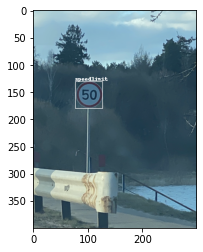

In [23]:
# to test annotations

random.seed(10)

class_id_to_name_mapping = dict(zip(class_name_to_id_mapping.values(), class_name_to_id_mapping.keys()))

def plot_bounding_box(image, annotation_list):
    annotations = np.array(annotation_list)
    w, h = image.size
    
    plotted_image = ImageDraw.Draw(image)

    transformed_annotations = np.copy(annotations)
    transformed_annotations[:,[1,3]] = annotations[:,[1,3]] * w
    transformed_annotations[:,[2,4]] = annotations[:,[2,4]] * h 
    
    transformed_annotations[:,1] = transformed_annotations[:,1] - (transformed_annotations[:,3] / 2)
    transformed_annotations[:,2] = transformed_annotations[:,2] - (transformed_annotations[:,4] / 2)
    transformed_annotations[:,3] = transformed_annotations[:,1] + transformed_annotations[:,3]
    transformed_annotations[:,4] = transformed_annotations[:,2] + transformed_annotations[:,4]
    
    for ann in transformed_annotations:
        obj_cls, x0, y0, x1, y1 = ann
        plotted_image.rectangle(((x0,y0), (x1,y1)))
        
        plotted_image.text((x0, y0 - 10), class_id_to_name_mapping[(int(obj_cls))])
    
    plt.imshow(np.array(image))
    plt.show()

# Get any random annotation file 
annotation_file = random.choice(annotations)
with open(annotation_file, "r") as file:
    annotation_list = file.read().split("\n")[:-1]
    annotation_list = [x.split(" ") for x in annotation_list]
    annotation_list = [[float(y) for y in x ] for x in annotation_list]

#Get the corresponding image file
image_file = annotation_file.replace("annotations", "images").replace("txt", "png")
assert os.path.exists(image_file)

#Load the image
image = Image.open(image_file)

#Plot the Bounding Box
plot_bounding_box(image, annotation_list)

In [24]:
# data partition: train (80%), validation(%10), and test sets(10%)
# Read images and annotations
images = [os.path.join('images', x) for x in os.listdir('images')]
annotations = [os.path.join('annotations', x) for x in os.listdir('annotations') if x[-3:] == "txt"]

images.sort()
annotations.sort()

# Split the dataset into train-valid-test splits 
train_images, val_images, train_annotations, val_annotations = train_test_split(images, annotations, test_size = 0.2, random_state = 1)
val_images, test_images, val_annotations, test_annotations = train_test_split(val_images, val_annotations, test_size = 0.5, random_state = 1)

In [27]:
# create folders 
!mkdir "images/train" "images/val" "images/test" "annotations/train" "annotations/val" "annotations/test"

In [28]:
#Utility function to move images 
def move_files_to_folder(list_of_files, destination_folder):
    for f in list_of_files:
        try:
            shutil.move(f, destination_folder)
        except:
            print(f)
            assert False

# Move the splits into their folders
move_files_to_folder(train_images, 'images/train')
move_files_to_folder(val_images, 'images/val/')
move_files_to_folder(test_images, 'images/test/')
move_files_to_folder(train_annotations, 'annotations/train/')
move_files_to_folder(val_annotations, 'annotations/val/')
move_files_to_folder(test_annotations, 'annotations/test/')

Rename annotations folder name to labels. 
The dataset folder name Road_Sign_Dataset it is located on ../yolov5 folder

In [10]:
os.chdir('..\\yolov5')

In [11]:
os.getcwd()

'C:\\Users\\gokce\\Documents\\MSc_DataScience\\Computer Vision\\project2022\\yolov5'

In [ ]:
!python train.py --img 640 --cfg yolov5s.yaml --hyp hyp.scratch.yaml --batch 8 --epochs 10 --data road_sign_data.yaml --weights yolov5s.pt --workers 24 --name yolo_road_det

In [5]:
!fiftyone convert -h

usage: fiftyone convert [-h] [--input-dir INPUT_DIR] [--input-type INPUT_TYPE]
                        [--output-dir OUTPUT_DIR] [--output-type OUTPUT_TYPE]

Convert datasets on disk between supported formats.

    Examples::

        # Convert an image classification directory tree to TFRecords format
        fiftyone convert \
            --input-dir /path/to/image-classification-directory-tree \
            --input-type fiftyone.types.ImageClassificationDirectoryTree \
            --output-dir /path/for/tf-image-classification-dataset \
            --output-type fiftyone.types.TFImageClassificationDataset

        # Convert a COCO detection dataset to CVAT image format
        fiftyone convert \
            --input-dir /path/to/coco-detection-dataset \
            --input-type fiftyone.types.COCODetectionDataset \
            --output-dir /path/for/cvat-image-dataset \
            --output-type fiftyone.types.CVATImageDataset

optional arguments:
  -h, --help            show this he

In [11]:
code = "fiftyone convert --input-dir " +  train_data_path + " --input-type fiftyone.types.VOCDetectionDataset --output-dir C:\\Users\\gokce\\Documents\\MSc_DataScience\\Computer Vision\\project2022\\trash_ICRA19\\dataset_coco\\train --output-type fiftyone.types.COCODetectionDataset"
convert_coco = run(code, shell=True, capture_output=True, text = True)
print(convert_coco.stdout)
    